## This notebook is mostly focused on EDA around the target.

In [36]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Make sure all columns are displayed
pd.set_option('display.max_columns', None)

In [37]:
# Read the data
df = pd.read_csv('../data/2015-street-tree-census-tree-data.csv')

In [38]:
# Only living trees
df_alive = df[df['status'] == 'Alive']

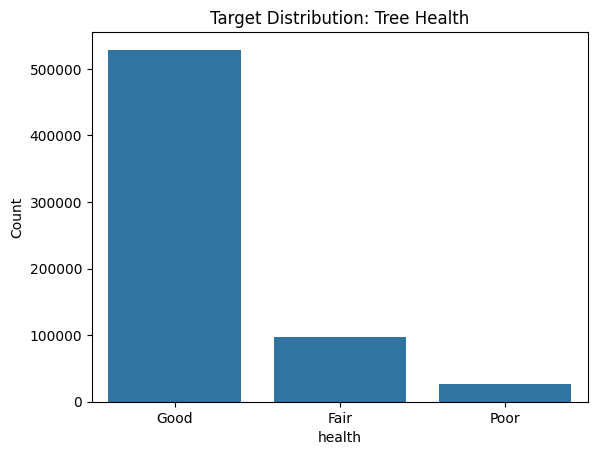

health
Good    0.811
Fair    0.148
Poor    0.041
Name: proportion, dtype: float64

In [39]:
sns.countplot(data=df_alive, x='health', order=['Good', 'Fair', 'Poor'])
plt.title('Target Distribution: Tree Health')
plt.ylabel('Count')
plt.show()

# Value counts
df_alive['health'].value_counts(normalize=True).round(3)

Highly Imbalanced Target
* "Good" health dominates the target, representing over 80% of all living trees.
* "Poor" health is underrepresented (~3%), making it a minority class.
* This is a classic multi-class imbalance problem.

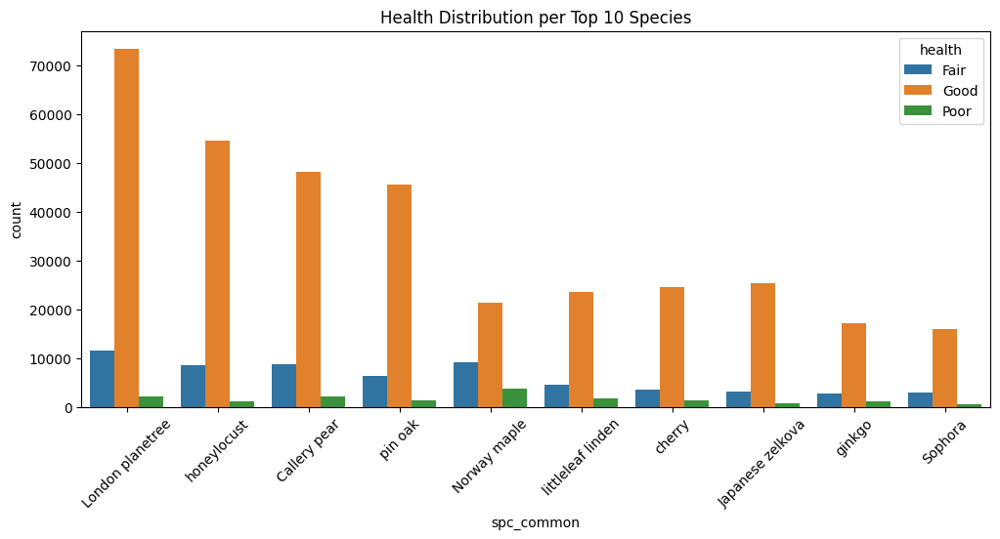

health,Fair,Good,Poor
spc_common,,,
Callery pear,0.148801,0.815751,0.035448
Japanese zelkova,0.109064,0.864208,0.026728
London planetree,0.132220,0.842520,0.025260
Norway maple,0.267981,0.621486,0.110533
Sophora,0.149447,0.818699,0.031854
cherry,0.117764,0.837665,0.044571
ginkgo,0.132230,0.814593,0.053177
honeylocust,0.133389,0.848093,0.018518
littleleaf linden,0.149284,0.792885,0.057831


In [45]:
top_species = df_alive['spc_common'].value_counts().head(10).index
subset = df_alive[df_alive['spc_common'].isin(top_species)]

plt.figure(figsize=(12, 5))
sns.countplot(data=subset, x='spc_common', hue='health', order=top_species)
plt.xticks(rotation=45)
plt.title('Health Distribution per Top 10 Species')
plt.show()

pd.crosstab(subset['spc_common'], subset['health'], normalize='index')

1. Best Performers:
    * Pin oak, honeylocust, and Japanese zelkova show the highest "Good" rates and lowest "Poor" rates.
2. Higher Risk Species:
    * Norway maple: Only ~62% "Good", with a staggering 11% "Poor" — may be aging, overplanted, or vulnerable.
    * Littleleaf linden and ginkgo also show elevated "Poor" rates (5–6%).

Can be suitable for feature engineering - create top species, other species

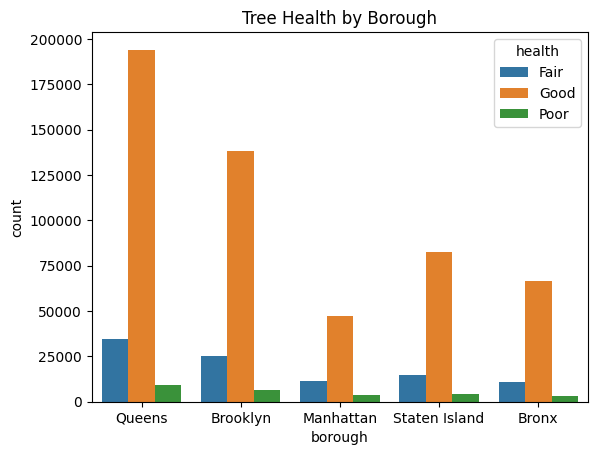

health,Fair,Good,Poor
borough,,,
Bronx,0.135100,0.826494,0.038407
Brooklyn,0.147711,0.814238,0.038051
Manhattan,0.183574,0.758614,0.057812
Queens,0.145180,0.815249,0.039572
Staten Island,0.143284,0.814939,0.041778


In [46]:
sns.countplot(data=df_alive, x='borough', hue='health')
plt.title('Tree Health by Borough')
plt.show()

pd.crosstab(df_alive['borough'], df_alive['health'], normalize='index')

1. Bronx Performs Best
    * High "Good" health
    * Low Fair and Poor percentages
    * Likely reflect:
        1. Well-established urban canopy
        2. Successful species mix or maintenance strategies

2. Manhattan Has the Worst Tree Health
    * Lowest Good % (75.86%)
    * Highest Fair (18.36%) and Poor (5.78%)
    * Likely due to:
        1. High density urban conditions
        2. Smaller planting pits
        3. Pollution, compaction, or infrastructure interference

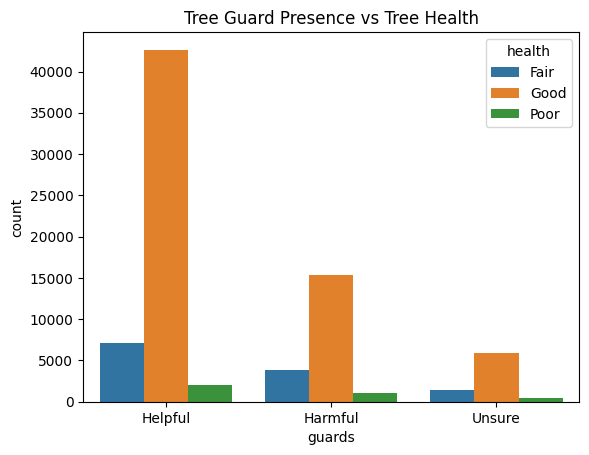

health,Fair,Good,Poor
guards,,,
Harmful,0.189562,0.756567,0.053871
Helpful,0.138164,0.822080,0.039756
Unsure,0.177594,0.763036,0.059370


In [48]:
sns.countplot(data=df_alive, x='guards', hue='health')
plt.title('Tree Guard Presence vs Tree Health')
plt.show()

pd.crosstab(df_alive['guards'], df_alive['health'], normalize='index')

1. Helpful Guards Clearly Improve Tree Outcomes
    * Trees with Helpful guards show the highest rate of “Good” health.
    * They also have the lowest “Poor” proportion (~4%).
2. Harmful and Unsure Guards Are Risk Factors
    * “Harmful” guards:
        1. Cause root/trunk constriction, trap debris, reduce water flow.
        2. Associated with higher "Fair" and "Poor" health rates.
    * “Unsure” guards:
        1. Possibly misclassified, makeshift, or ambiguous designs.
        2. Highest "Poor" rate (~6%) of all three.

Though we have a lot of missing values, this feature is still influence the target, 'll try to keep it.

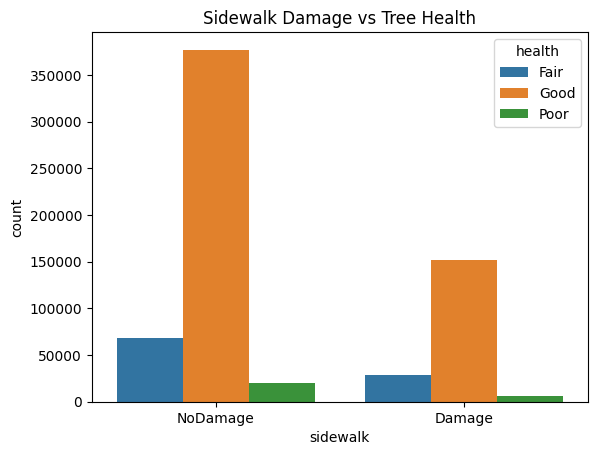

health,Fair,Good,Poor
sidewalk,,,
Damage,0.153312,0.811403,0.035284
NoDamage,0.145824,0.810705,0.043471


In [49]:
sns.countplot(data=df_alive, x='sidewalk', hue='health')
plt.title('Sidewalk Damage vs Tree Health')
plt.show()

pd.crosstab(df_alive['sidewalk'], df_alive['health'], normalize='index')

1. Sidewalk Damage May Reflect Large, Healthy Trees
    * Trees with larger DBH are more likely to heave or crack sidewalks.
    * These trees may also be:
        1. Older and well-established
        2. More resilient to stressors

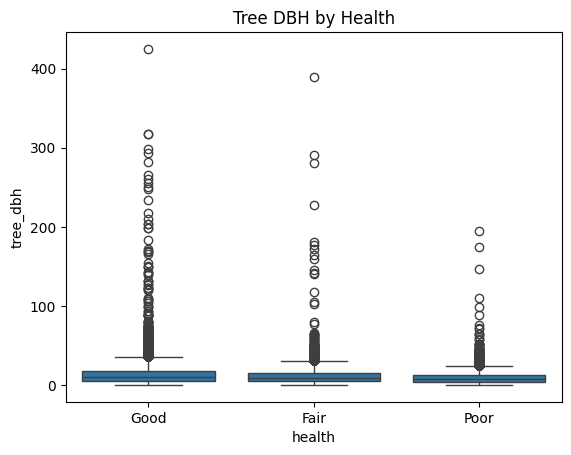

In [10]:
sns.boxplot(data=df_alive, x='health', y='tree_dbh', order=['Good', 'Fair', 'Poor'])
plt.title('Tree DBH by Health')
plt.show()

In [50]:
# Bin tree_dbh into categories
bins = [0, 6, 12, 24, 36, 60, df_alive['tree_dbh'].max()]
labels = ['0-6', '7-12', '13-24', '25-36', '37-60', '60+']
df_alive['dbh_bin'] = pd.cut(df_alive['tree_dbh'], bins=bins, labels=labels)
pd.crosstab(df_alive['dbh_bin'], df_alive['health'], normalize='index')

C:\Users\IlyaPastushkov\AppData\Local\Temp\ipykernel_17132\3635619752.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_alive['dbh_bin'] = pd.cut(df_alive['tree_dbh'], bins=bins, labels=labels)


health,Fair,Good,Poor
dbh_bin,,,
0-6,0.153030,0.791269,0.055700
7-12,0.154829,0.804009,0.041162
13-24,0.150598,0.817830,0.031572
25-36,0.103956,0.880667,0.015376
37-60,0.084291,0.902069,0.013640
60+,0.153333,0.766667,0.080000


1. Mid-to-Large Trees (25–60") Are the Sweet Spot
    * Highest “Good” percentages (88–90%)
    * Lowest “Poor” percentages (1.3–1.5%)
    * Likely well-established, adapted to the urban environment, and regularly maintained

2. Youngest Trees (0–6") Are Most at Risk
    * Highest “Poor” rate (5.6%) and lowest “Good” (79%)
    * May not have fully adapted, or are affected by planting shock, limited roots, or insufficient care

3. Very Large Trees (60+") Show Declining Health
    * “Poor” rate jumps to 8%
    * Could be due to:
        1. Age-related decline
        2. Structural issues
        3. Removal candidates
        4. Infrastructure conflict (e.g., root damage, sidewalk lift)

Will be used as feature for modelling further.

In [52]:
# Problem flags
problem_cols = ['root_stone', 'root_grate', 'root_other', 
                'trunk_wire', 'trnk_light', 'trnk_other', 
                'brch_light', 'brch_shoe', 'brch_other']

# Count problems per tree
df_alive['problem_count'] = df_alive[problem_cols].apply(lambda row: sum(row == 'Yes'), axis=1)


C:\Users\IlyaPastushkov\AppData\Local\Temp\ipykernel_17132\1132833792.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_alive['problem_count'] = df_alive[problem_cols].apply(lambda row: sum(row == 'Yes'), axis=1)


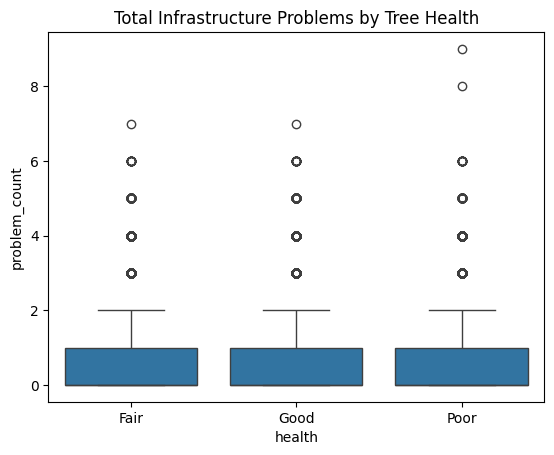

health,Fair,Good,Poor
problem_count,,,
0,0.126574,0.837048,0.036378
1,0.172277,0.787207,0.040516
2,0.218702,0.720482,0.060817
3,0.257785,0.630859,0.111356
4,0.284073,0.587163,0.128764
5,0.337349,0.421687,0.240964
6,0.306122,0.367347,0.326531
7,0.500000,0.500000,0.000000
8,0.000000,0.000000,1.000000


In [53]:
# Already created earlier
sns.boxplot(data=df_alive, x='health', y='problem_count')
plt.title('Total Infrastructure Problems by Tree Health')
plt.show()

pd.crosstab(df_alive['problem_count'], df_alive['health'], normalize='index')

1. Clear Negative Correlation
    * As problem_count increases:
    * "Good" health drops steeply (from 83.7% → 36.7%)
    * "Poor" health surges (from 3.6% → 32.7%+)

2. Tipping Point at 3+ Problems
    * From 3 upward, "Poor" health doubles
    * From 5+ problems, Good health is no longer the majority

3. Extreme Counts (8, 9) → 100% "Poor"

Will be used as feature for modeling.

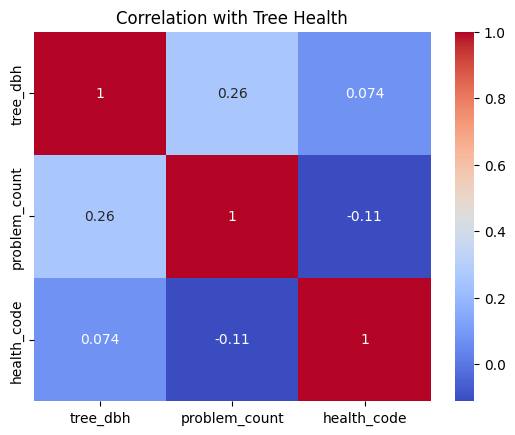

In [54]:
numeric_cols = ['tree_dbh', 'problem_count']
corr_data = df_alive[numeric_cols].copy()
corr_data['health_code'] = df_alive['health'].map({'Good': 2, 'Fair': 1, 'Poor': 0})  # Encode health

sns.heatmap(corr_data.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation with Tree Health')
plt.show()

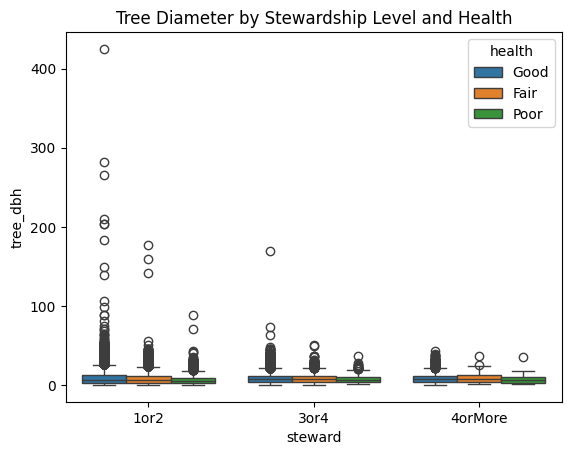

health,Fair,Good,Poor
steward,,,
1or2,0.152567,0.803667,0.043767
3or4,0.147526,0.813533,0.038941
4orMore,0.124224,0.845342,0.030435


In [55]:
sns.boxplot(data=df_alive[df_alive['steward'].notna()], 
            x='steward', y='tree_dbh', hue='health')
plt.title('Tree Diameter by Stewardship Level and Health')
plt.show()

# Filter to rows with stewardship data
df_steward = df_alive[df_alive['steward'].notna()]

# Create normalized crosstab
pd.crosstab(df_steward['steward'], df_steward['health'], normalize='index')

1. More Stewardship = Healthier Trees
    * There is a clear positive trend:
    * As stewardship level increases from 1or2 → 4orMore, the "Good" health % rises (80.4% → 84.5%)
    * At the same time, "Poor" health drops (4.4% → 3.0%)
2. "4orMore" Is the Sweet Spot
    * Trees with the highest observed care efforts have:
    * The highest "Good" rate
    * The lowest "Fair" and "Poor" rates
    * Indicates consistent, visible stewardship correlates with significantly better tree health

Though we have a lot of missing values, this feature is still influence the target, 'll try to keep it.

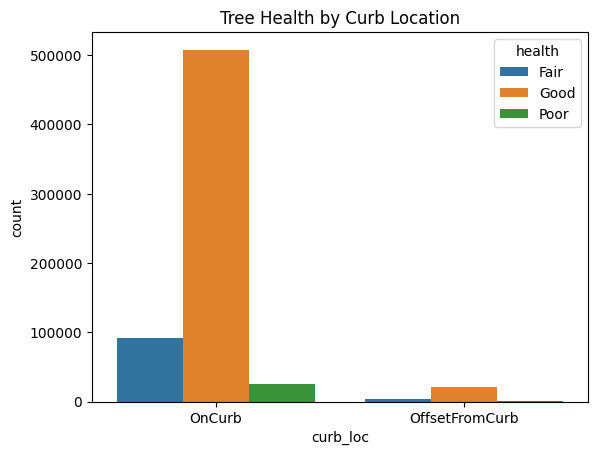

health,Fair,Good,Poor
curb_loc,,,
OffsetFromCurb,0.155942,0.806841,0.037217
OnCurb,0.147644,0.811074,0.041282


In [56]:
sns.countplot(data=df_alive, x='curb_loc', hue='health')
plt.title('Tree Health by Curb Location')
plt.show()
pd.crosstab(df_alive['curb_loc'], df_alive['health'], normalize='index')

1. Good health is nearly equal in both locations (within 0.5%)
2. Poor health is slightly higher for OnCurb trees (4.13% vs. 3.72%)

While the difference is small, it reinforces a consistent theme:
Offset trees are marginally healthier.

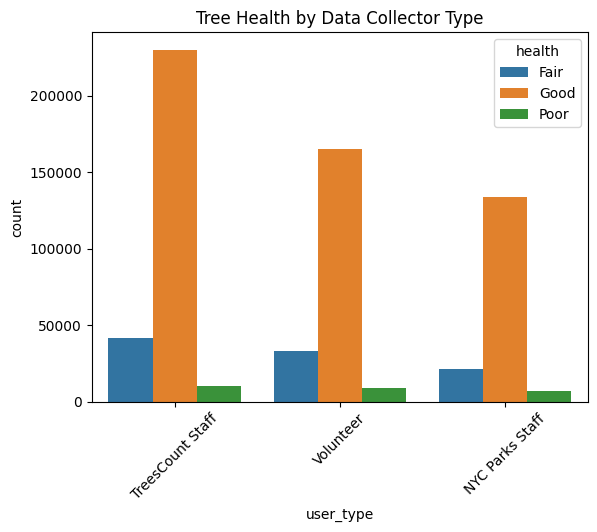

health,Fair,Good,Poor
user_type,,,
NYC Parks Staff,0.131093,0.824315,0.044592
TreesCount Staff,0.148067,0.814655,0.037278
Volunteer,0.161019,0.795348,0.043633


In [57]:
sns.countplot(data=df_alive, x='user_type', hue='health')
plt.title('Tree Health by Data Collector Type')
plt.xticks(rotation=45)
plt.show()

pd.crosstab(df_alive['user_type'], df_alive['health'], normalize='index')

1. All Groups Rate Most Trees as "Good"
    * Overall “Good” rates across all groups hover between 79%–82%.
    * No major bias detected — good consistency.
2. Volunteers Tend to Report Slightly Lower Health
    * Lowest “Good” % (79.5%)
    * Highest “Fair” % (16.1%)
    * Possibly:
        1. More conservative in rating
        2. Less experienced or trained
        3. Encountering different environments (e.g., mapped neighborhoods)

In [35]:
# Define rare problem features
rare_probs = ['trnk_light', 'trunk_wire', 'brch_light', 'brch_shoe']

# Loop through and display normalized crosstabs
for col in rare_probs:
    print(f'\n--- {col} vs health ---')
    crosstab = pd.crosstab(df_alive[col], df_alive['health'], normalize='index')
    print(crosstab.round(3))


--- trnk_light vs health ---
health       Fair   Good   Poor
trnk_light                     
No          0.148  0.811  0.041
Yes         0.210  0.731  0.059

--- trunk_wire vs health ---
health       Fair   Good   Poor
trunk_wire                     
No          0.147  0.812  0.041
Yes         0.208  0.735  0.057

--- brch_light vs health ---
health       Fair   Good   Poor
brch_light                     
No          0.145  0.813  0.041
Yes         0.175  0.787  0.038

--- brch_shoe vs health ---
health      Fair   Good   Poor
brch_shoe                     
No         0.148  0.811  0.041
Yes        0.229  0.693  0.078


1. General Pattern:
    * For almost all issues, trees with "Yes" status show:
        1. Higher "Fair" and "Poor"
        2. Lower "Good"
        3. These problems are rare, but strongly associated with stress or damage

2. Special Attention: brch_shoe:
    * “Poor” health jumps to 7.8%
    * “Good” drops to 69.3% — well below average

In [27]:
infra_cols = ['root_stone', 'root_grate', 'root_other', 
              'trunk_wire', 'trnk_light', 'trnk_other', 
              'brch_light', 'brch_shoe', 'brch_other']

for col in infra_cols:
    ratio = (
        df_alive[df_alive[col].notna()]
        .groupby(col)['health']
        .value_counts(normalize=True)
        .unstack()
    )
    if 'Poor' in ratio.columns:
        print(f"\n--- {col} ---")
        print(ratio['Poor'])


--- root_stone ---
root_stone
No     0.042232
Yes    0.037057
Name: Poor, dtype: float64

--- root_grate ---
root_grate
No     0.040952
Yes    0.072115
Name: Poor, dtype: float64

--- root_other ---
root_other
No     0.039719
Yes    0.069883
Name: Poor, dtype: float64

--- trunk_wire ---
trunk_wire
No     0.040798
Yes    0.056652
Name: Poor, dtype: float64

--- trnk_light ---
trnk_light
No     0.041092
Yes    0.059166
Name: Poor, dtype: float64

--- trnk_other ---
trnk_other
No     0.036956
Yes    0.120345
Name: Poor, dtype: float64

--- brch_light ---
brch_light
No     0.041451
Yes    0.038002
Name: Poor, dtype: float64

--- brch_shoe ---
brch_shoe
No     0.041098
Yes    0.077859
Name: Poor, dtype: float64

--- brch_other ---
brch_other
No     0.036890
Yes    0.150195
Name: Poor, dtype: float64


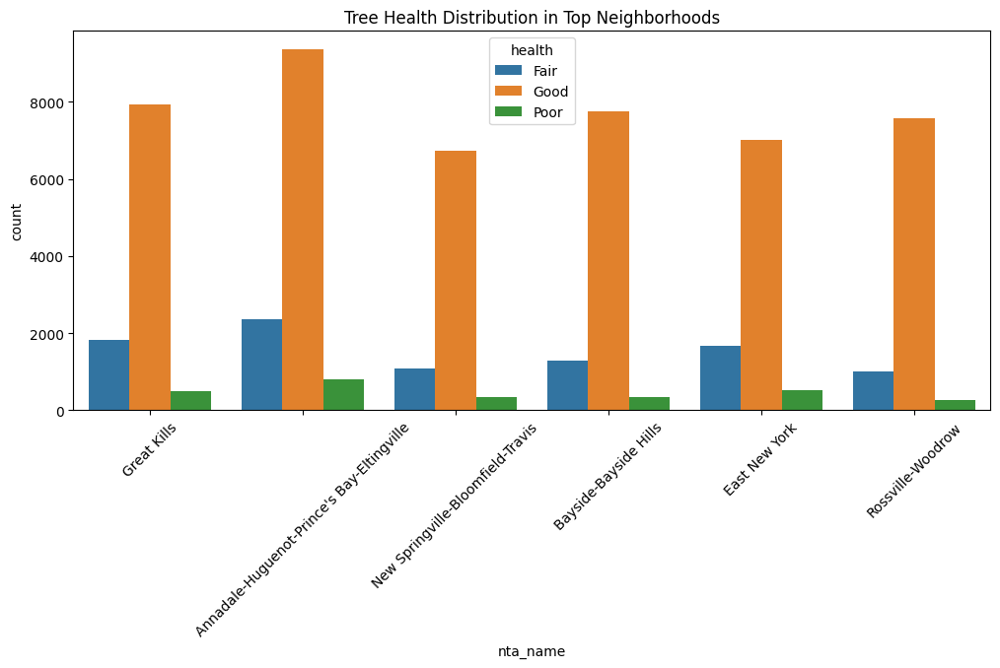

In [28]:
top_nta = df_alive['nta_name'].value_counts().head(6).index
subset = df_alive[df_alive['nta_name'].isin(top_nta)]

plt.figure(figsize=(12, 5))
sns.countplot(data=subset, x='nta_name', hue='health')
plt.title('Tree Health Distribution in Top Neighborhoods')
plt.xticks(rotation=45)
plt.show()

In [34]:
pd.crosstab(subset['nta_name'], subset['health'], normalize='index')

health,Fair,Good,Poor
nta_name,,,
Annadale-Huguenot-Prince's Bay-Eltingville,0.188747,0.747406,0.063847
Bayside-Bayside Hills,0.138185,0.825911,0.035905
East New York,0.181323,0.761646,0.057031
Great Kills,0.178631,0.772475,0.048895
New Springville-Bloomfield-Travis,0.133382,0.825104,0.041513
Rossville-Woodrow,0.114001,0.855349,0.030649


1. Rossville–Woodrow = Most Resilient Trees
    * Highest "Good" health and lowest "Poor" among the group.
2. Annadale & East New York = Areas of Concern
    * Higher "Poor" and "Fair" percentages than others
3. Suburban NTAs Do Better Than Urban-Dense Zones
    * Staten Island neighborhoods (Rossville, New Springville, Great Kills) generally outperform Brooklyn (East NY) or denser parts of Queens.

In [60]:
import folium
from folium.plugins import MarkerCluster

# Sample poor trees
poor = df_alive[df_alive['health'] == 'Poor'].dropna(subset=['latitude', 'longitude'])#.sample(1000)

m = folium.Map(location=[40.7, -73.95], zoom_start=11)
mc = MarkerCluster().add_to(m)

for _, row in poor.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['spc_common']} ({row['tree_dbh']} in)"
    ).add_to(mc)

m